# 準備

In [1]:
import torch

# GPU が使用できる場合は GPU (= cuda) を指定し、
# そうでない場合は CPU を指定
device = torch.device(
    "cuda" if torch.cuda.is_available() else "cpu"
)
# 通常は単精度 (float32) を使用するが、
# メモリ使用量削減のため半精度 (float16)を使用
dtype = torch.float16
# 生成結果の再現性を確保するためにシード値を設定
seed = 42

In [2]:
import logging

# error ログのみを表示する
logger_name = "diffusers.pipelines.pipeline_utils"
logging.getLogger(logger_name).setLevel(logging.ERROR)

# Stable Diffusion を扱うパイプラインの構築

In [3]:
from diffusers import StableDiffusionPipeline

model_id = "stable-diffusion-v1-5/stable-diffusion-v1-5"

pipe = StableDiffusionPipeline.from_pretrained(
    model_id, torch_dtype=dtype
)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [4]:
print(f"Move pipeline to {device}")

pipe = pipe.to(device)

Move pipeline to cuda


  0%|          | 0/50 [00:00<?, ?it/s]

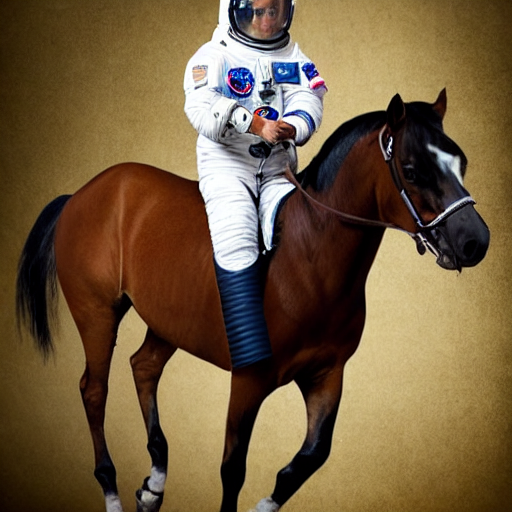

In [5]:
# 訳: 宇宙飛行士が馬に乗っている写真
text = "a photograph of an astronaut riding a horse"

# 画像を生成
output = pipe(prompt=text)

# ここで image は
# pillow (https://pillow.readthedocs.io/en/stable) 形式
image = output.images[0]

# 画像を表示
image

  0%|          | 0/50 [00:00<?, ?it/s]

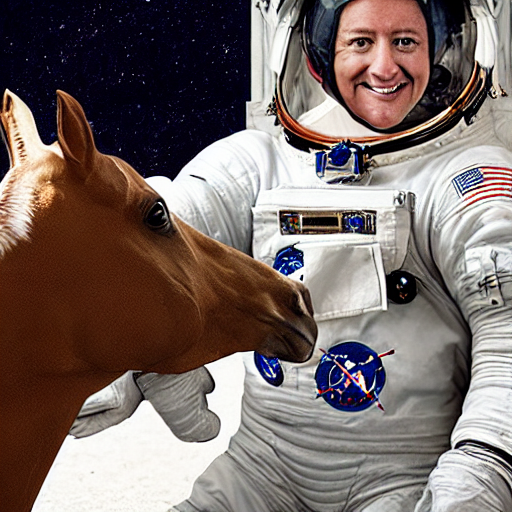

In [6]:
# 乱数生成器に指定されたシード値を設定
generator = torch.manual_seed(seed)

# pipe の引数である generator に上記の乱数生成器を渡して画像を生成
output = pipe(prompt=text, generator=generator)
image = output.images[0]
image  # 画像を表示

  0%|          | 0/15 [00:00<?, ?it/s]

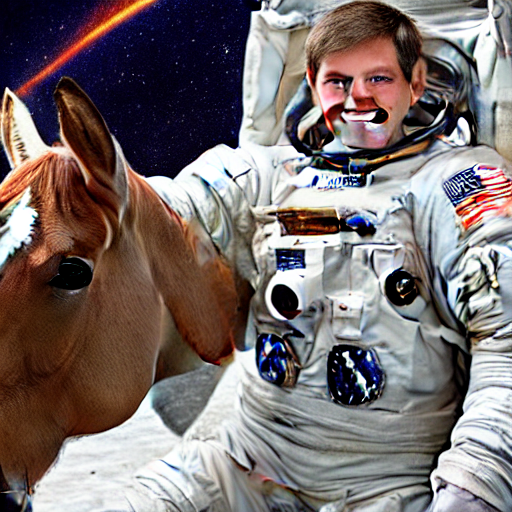

In [7]:
generator = torch.manual_seed(seed)

# 推論時のステップ数である num_inference_steps を 15 に設定 (デフォルトは 50)
output = pipe(
    prompt=text, generator=generator, num_inference_steps=15
)
image = output.images[0]
image  # 画像を表示

  0%|          | 0/50 [00:00<?, ?it/s]

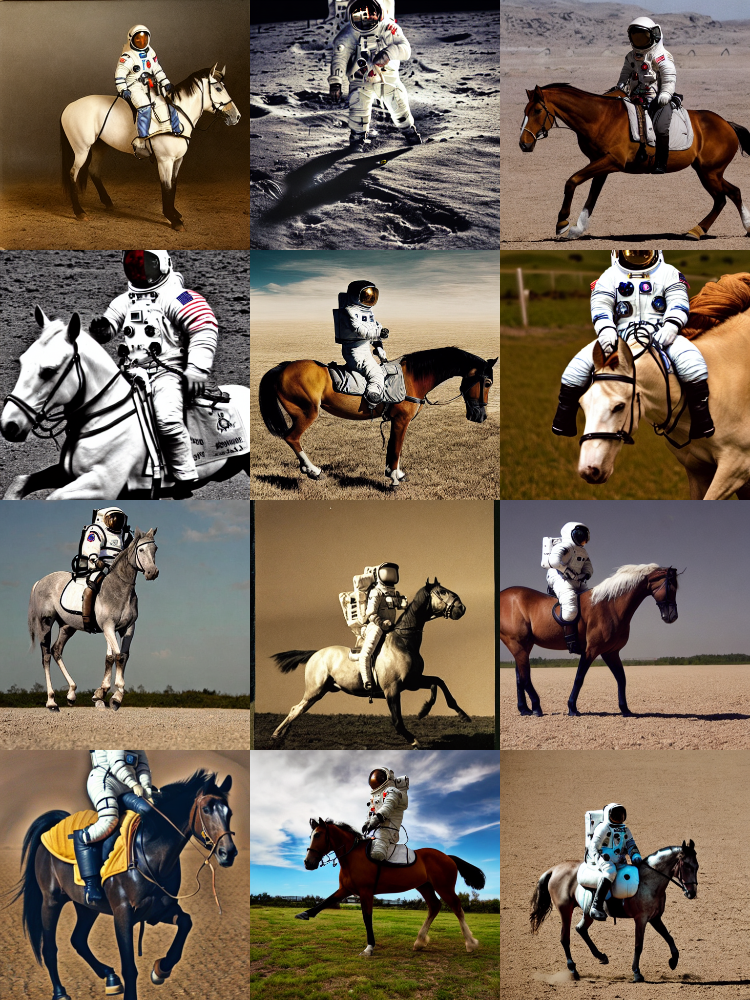

In [8]:
from diffusers.utils import make_image_grid

text = "a photograph of an astronaut riding a horse"

num_rows, num_cols = 4, 3  # 行数・列数を指定
num_images = num_rows * num_cols  # 生成画像数

output = pipe(prompt=text, num_images_per_prompt=num_images)

# make_image_grid 関数を使用してグリッド上に複数生成画像を表示
make_image_grid(
    images=output.images, rows=num_rows, cols=num_cols
)

# Stable Diffusion v1 による画像生成

  0%|          | 0/50 [00:00<?, ?it/s]

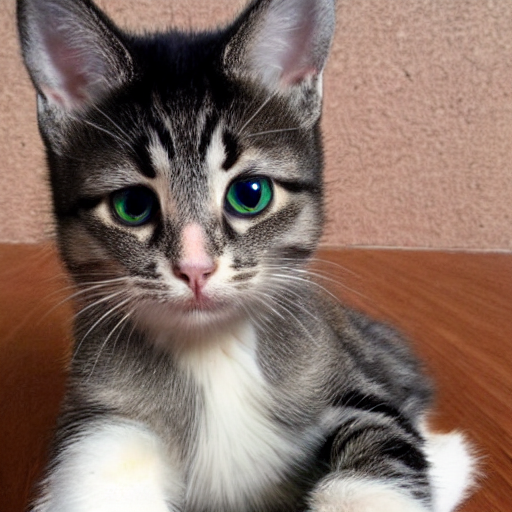

In [9]:
# 吾輩は猫である。名前はまだ無い。（夏目漱石「吾輩は猫である」冒頭より）
text = "I am a cat. As yet I have no name."

# シード値を固定して画像を生成
output = pipe(
    prompt=text, generator=torch.manual_seed(seed)
)
image = output.images[0]
image  # 画像を表示

  0%|          | 0/50 [00:00<?, ?it/s]

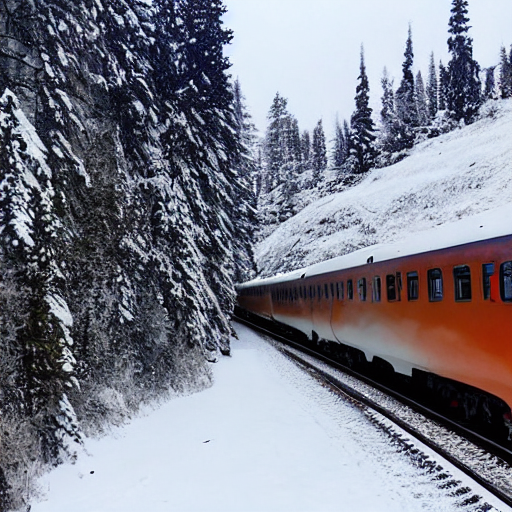

In [10]:
# 国境の長いトンネルを抜けると雪国であった。（川端康成「雪国」冒頭より）
text = "The train came out of the long tunnel into the snow country."

# シード値を固定して画像を生成
output = pipe(
    prompt=text, generator=torch.manual_seed(seed)
)
image = output.images[0]
image  # 画像を表示

  0%|          | 0/50 [00:00<?, ?it/s]

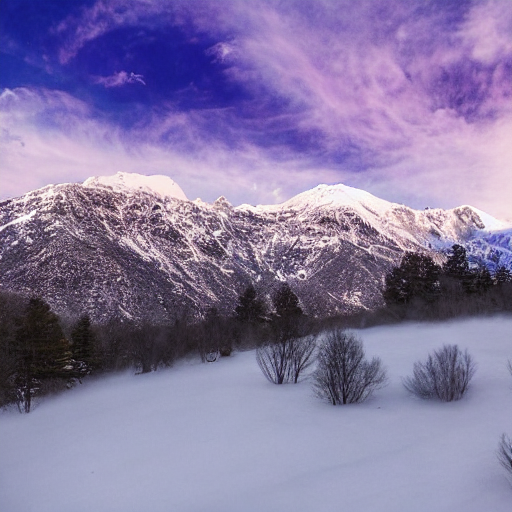

In [11]:
# 春はあけぼの、ようよう白く成りゆく山際、少し明かりて、紫だちたる雲の細くたなびきたる。
# （清少納言「枕草子」冒頭より）
text = "In the dawn of spring, the mountains are turning white, and the purple clouds are trailing thinly with a little light"

output = pipe(
    prompt=text, generator=torch.manual_seed(seed)
)
image = output.images[0]
image  # 画像を表示

In [12]:
import gc

pipe = pipe.to("cpu")
del pipe
gc.collect()
torch.cuda.empty_cache()

# Stable Diffusion v2 による画像生成

In [13]:
model_id = "stabilityai/stable-diffusion-2"

pipe = StableDiffusionPipeline.from_pretrained(
    model_id, torch_dtype=dtype
)
pipe = pipe.to(device)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [14]:
pipe.enable_attention_slicing()

  0%|          | 0/50 [00:00<?, ?it/s]

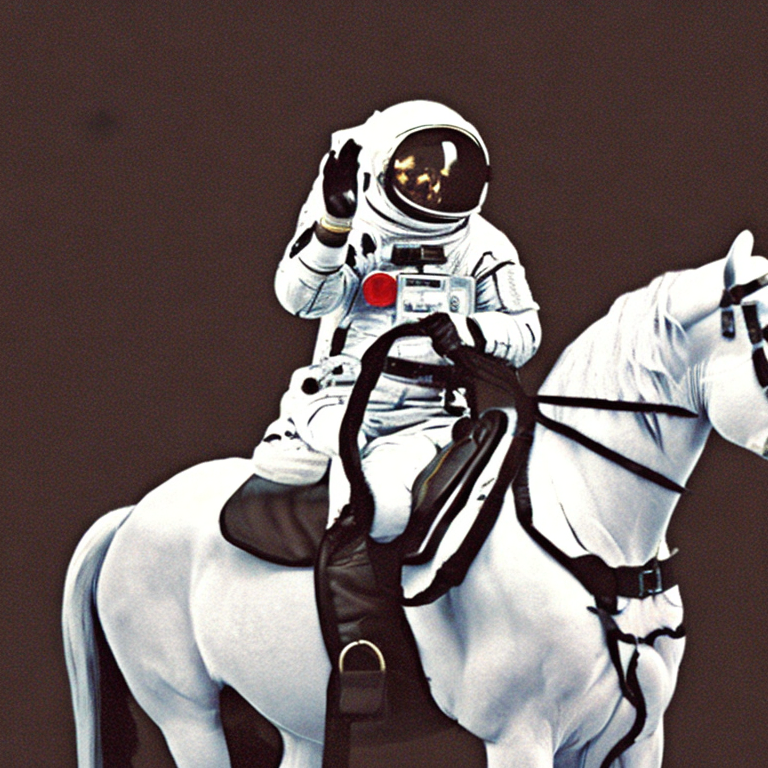

In [15]:
text = "a photograph of an astronaut riding a horse"

generator = torch.manual_seed(seed)
output = pipe(prompt=text, generator=generator)
image = output.images[0]
image  # 画像を表示

  0%|          | 0/50 [00:00<?, ?it/s]

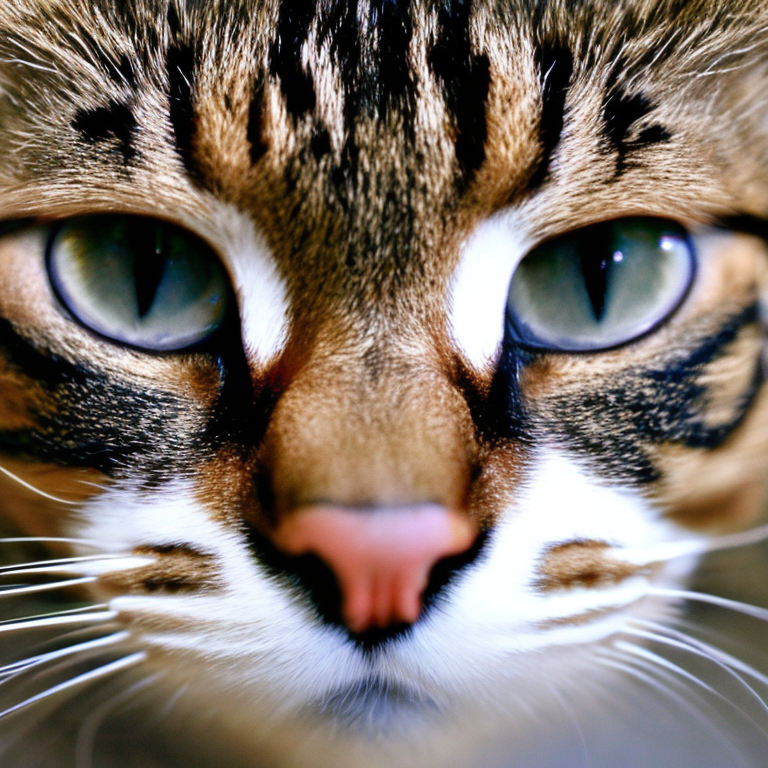

In [16]:
# 吾輩は猫である。名前はまだ無い。
text = "I am a cat. As yet I have no name."

output = pipe(
    prompt=text, generator=torch.manual_seed(seed)
)
image = output.images[0]
image  # 画像を表示

  0%|          | 0/50 [00:00<?, ?it/s]

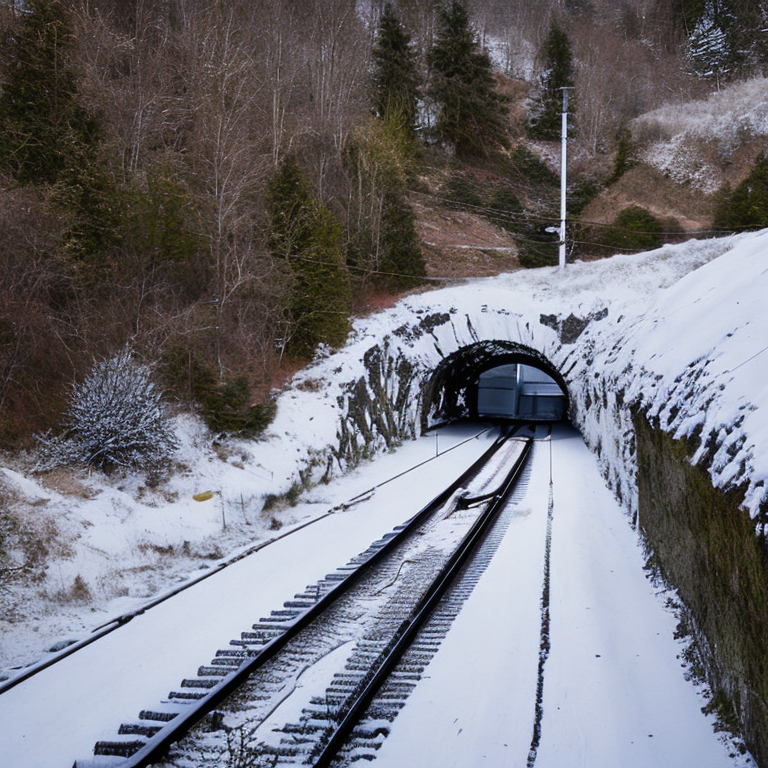

In [17]:
# 国境の長いトンネルを抜けると雪国であった。
text = "The train came out of the long tunnel into the snow country."

output = pipe(
    prompt=text, generator=torch.manual_seed(seed)
)
image = output.images[0]
image  # 画像を表示

  0%|          | 0/50 [00:00<?, ?it/s]

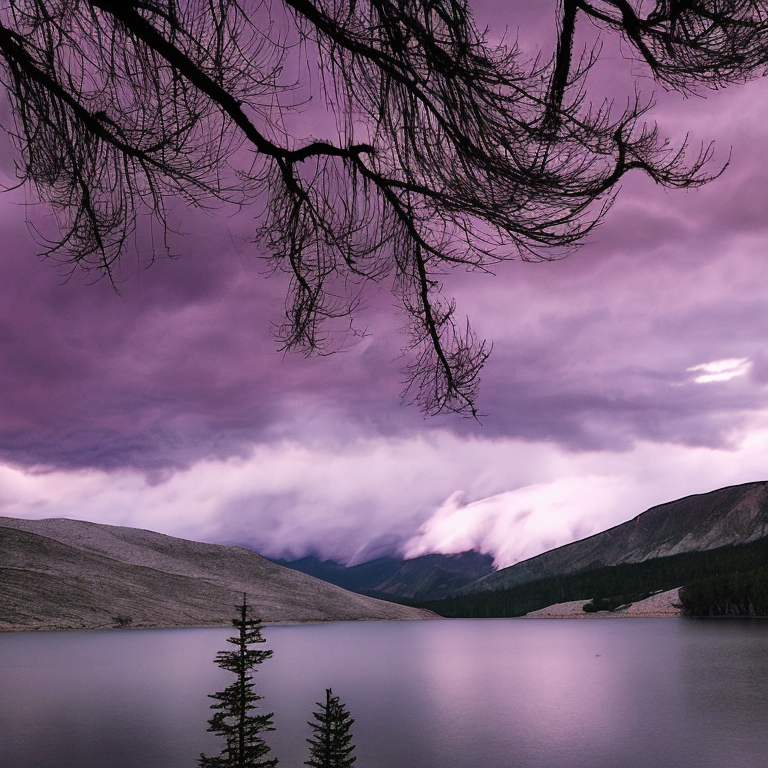

In [18]:
# 春はあけぼの、ようよう白く成りゆく山際、少し明かりて、紫だちたる雲の細くたなびきたる。
text = "In the dawn of spring, the mountains are turning white, and the purple clouds are trailing thinly with a little light"

output = pipe(
    prompt=text, generator=torch.manual_seed(seed)
)
image = output.images[0]
image  # 画像を表示

In [19]:
pipe = pipe.to("cpu")
del pipe
gc.collect()
torch.cuda.empty_cache()

# waifu-diffusion による画像生成

In [20]:
pipe = StableDiffusionPipeline.from_pretrained(
    "hakurei/waifu-diffusion", torch_dtype=dtype
)
pipe = pipe.to(device)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


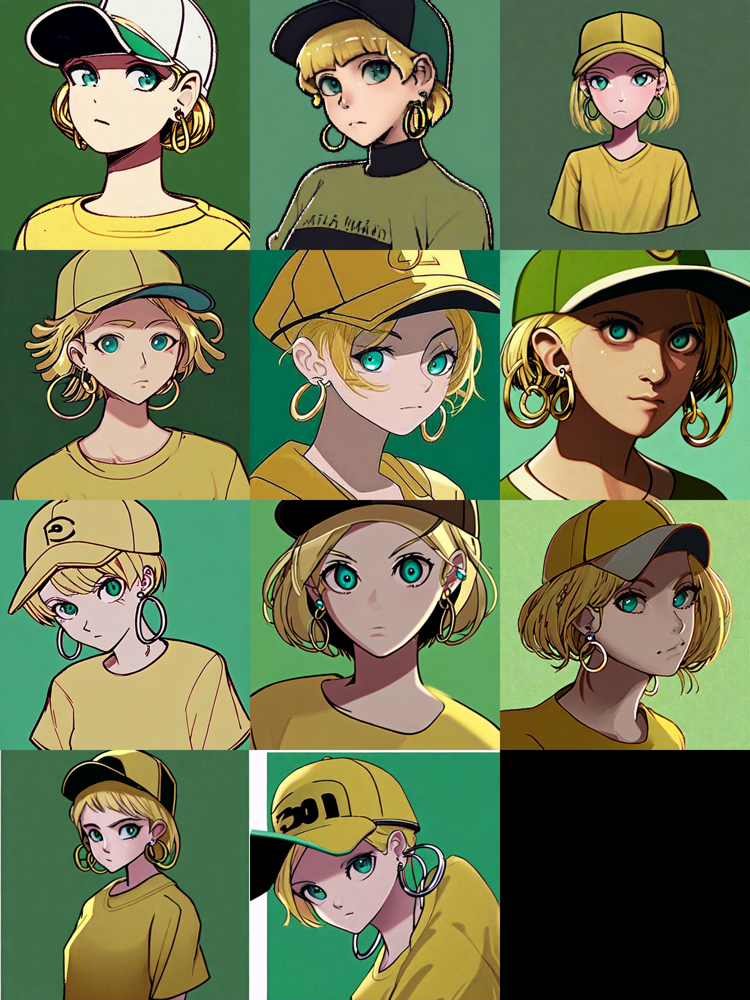

In [21]:
text = "1girl, aqua eyes, baseball cap, blonde hair, closed mouth, earrings, green background, hat, hoop earrings, jewelry, looking at viewer, shirt, short hair, simple background, solo, upper body, yellow shirt"

num_rows, num_cols = 4, 3
num_images = num_rows * num_cols

generator = torch.manual_seed(seed)
output = pipe(
    prompt=text,
    generator=generator,
    num_images_per_prompt=num_images,
)

make_image_grid(output.images, rows=num_rows, cols=num_cols)

In [22]:
pipe = pipe.to("cpu")
del pipe
gc.collect()
torch.cuda.empty_cache()

# nitro-diffusion による画像生成

In [23]:
pipe = StableDiffusionPipeline.from_pretrained(
    "nitrosocke/nitro-diffusion", torch_dtype=dtype
)
pipe = pipe.to(device)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

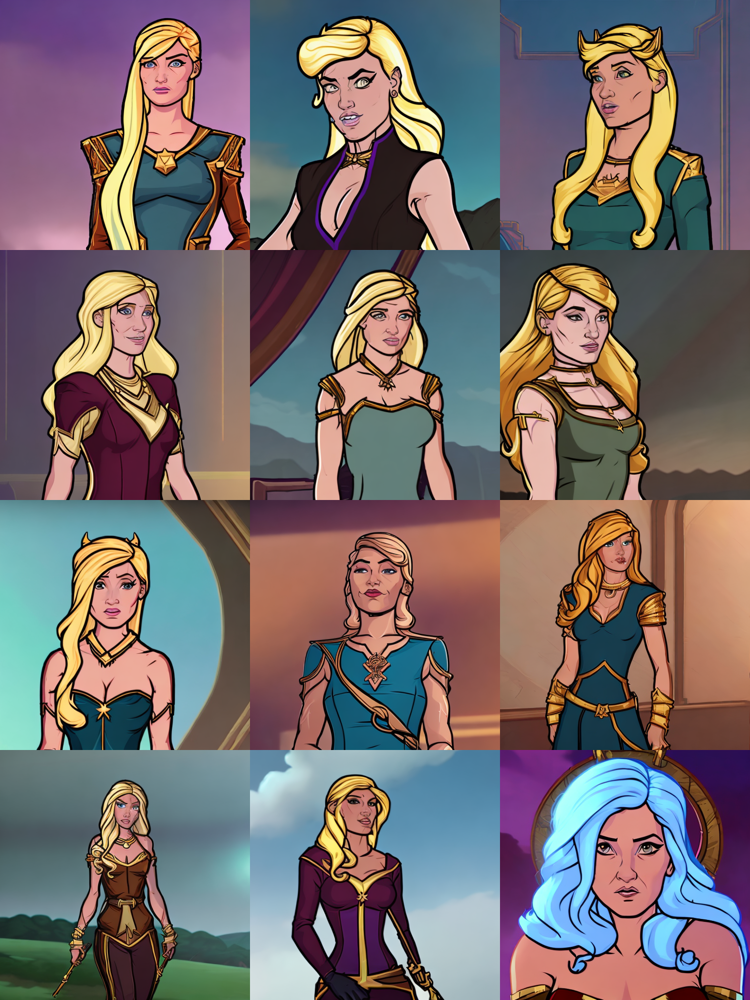

In [24]:
text = (
    "archer arcane style magical princess with golden hair"
)

num_rows, num_cols = 4, 3
num_images = num_rows * num_cols

generator = torch.manual_seed(seed)
output = pipe(
    prompt=text,
    generator=generator,
    num_images_per_prompt=num_images,
)

make_image_grid(output.images, rows=num_rows, cols=num_cols)

In [25]:
pipe = pipe.to("cpu")
del pipe
gc.collect()
torch.cuda.empty_cache()